In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

# Import standard libraries
import os, sys
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.pyplot as plt
import copy
import astropy.units as u
import emcee, corner
import seaborn as sns
import pandas as pd

import chimera

import coronagraph as cg
import smart
import smarter; smarter.utils.plot_setup()

/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/locations.py:345: UserWarning: Extinction files not found in /Users/lustija1/Documents/PandExo_data/pysynphot_data/extinction
  warnings.warn('Extinction files not found in %s' % (extdir, ))
/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/refs.py:117: UserWarning: No graph or component tables found; functionality will be SEVERELY crippled. No files found for /Users/lustija1/Documents/PandExo_data/pysynphot_data/mtab/*_tmg.fits
  warnings.warn('No graph or component tables found; '
/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/refs.py:124: UserWarning: No thermal tables found, no thermal calculations can be performed. No files found for /Users/lustija1/Documents/PandExo_data/pysynphot_data/mtab/*_tmt.fits
  warnings.warn('No thermal tables found, '


In [2]:
import run_wasp43_free_mcmc as exopie

Loading Synthetic Data and xsecs...


In [4]:
import dill as pickle

with open("optimization.pkl", 'rb') as file:
    popt, pcov, perr, p0 = pickle.load(file)

In [22]:
import seaborn as sns

df = pd.DataFrame(p0, columns=exopie.THETA_NAMES)
_ = sns.pairplot(df, corner=True, diag_kws={"bins" : 20, "alpha" : 1.0})

In [9]:
# Make gaussian ball from optimization covariance diag
gball = [
    smarter.priors.GaussianPrior(popt[i], perr[i], theta_name = exopie.THETA_NAMES[i], theta0=exopie.THETA0[i]) 
    for i in range(len(exopie.THETA_NAMES))
]

In [11]:
# Get n random samples from each of your parameter prior
n = 5000
samples = np.vstack([dim.random_sample(n) for dim in gball]).T

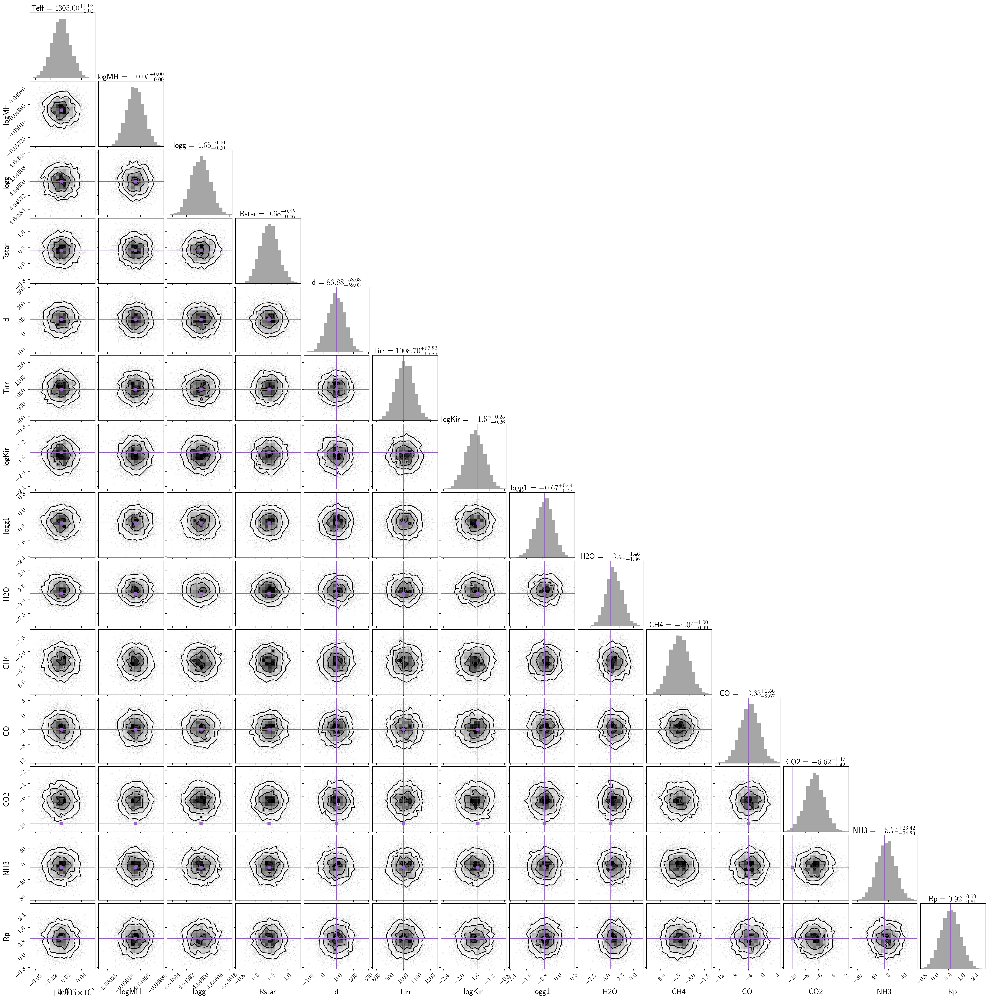

In [23]:
# Make corner plot
fig = corner.corner(samples, labels = exopie.THETA_NAMES, show_titles=True, truths=exopie.THETA0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)

In [50]:
# Make gaussian ball 
gball2 = []
for i in range(len(exopie.THETA_NAMES)):
    if hasattr(exopie.PRIORS[i], "sigma"):
        # If the prior is more constraining than the likelihood or the likelihood is a delta function
        if (exopie.PRIORS[i].sigma < perr[i]) or (perr[i] < 1e-15):
            # Use the prior
            gball2.append(exopie.PRIORS[i])
        else: 
            # Use the gaussian posterior
            gball2.append(smarter.priors.GaussianPrior(popt[i], perr[i], theta_name = exopie.THETA_NAMES[i], theta0=exopie.THETA0[i]))
    else:
        # Use the gaussian posterior
        gball2.append(smarter.priors.GaussianPrior(popt[i], perr[i], theta_name = exopie.THETA_NAMES[i], theta0=exopie.THETA0[i]))

In [46]:
# Get n random samples from each of your parameter prior
n = 5000
samples2 = np.vstack([dim.random_sample(n) for dim in gball2]).T

In [47]:
p0.shape

(140, 14)

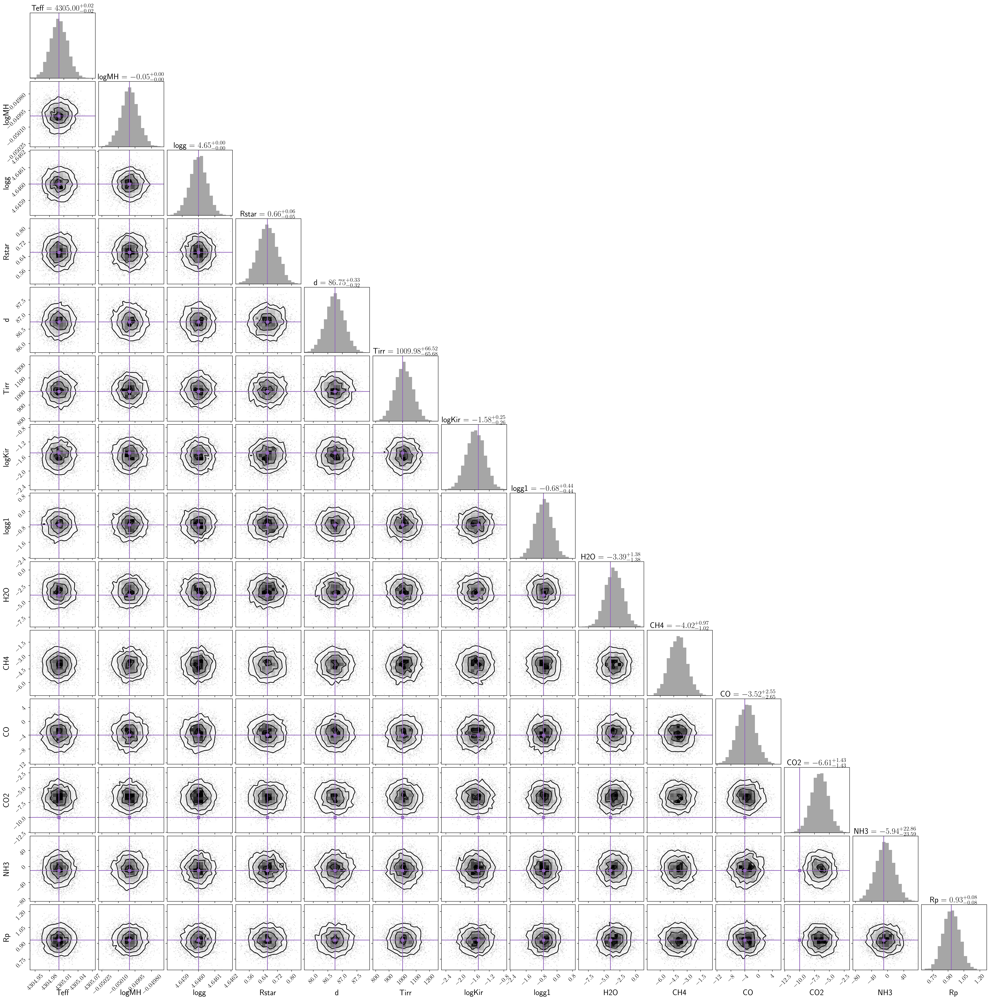

In [38]:
# Make corner plot
fig = corner.corner(samples2, labels = exopie.THETA_NAMES, show_titles=True, truths=exopie.THETA0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)

In [20]:
tag = "test_free2"; iburn = 0

# Create useful things
emcee_backend = str(tag) + "_emcee.h5"
theta_names = exopie.THETA_NAMES
theta0 = exopie.THETA0

# Create an HDF5 backend
backend = emcee.backends.HDFBackend(emcee_backend)

Mean acceptance fraction: 25.07%
Mean autocorrelation time: 4.933 steps


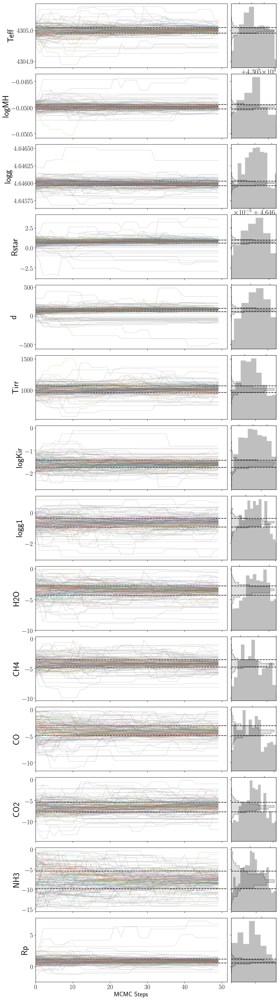

In [21]:
fig, m = exopie.plot_mcmc_trace("example", saveplot=False, iburn0=iburn, 
                                          emcee_backend=backend, labels = theta_names, 
                                          accept_quantiles=[0.2, 0.5, 0.8], show_quantiles=True)

In [24]:
flatchain = backend.get_chain(flat=True, discard = iburn)

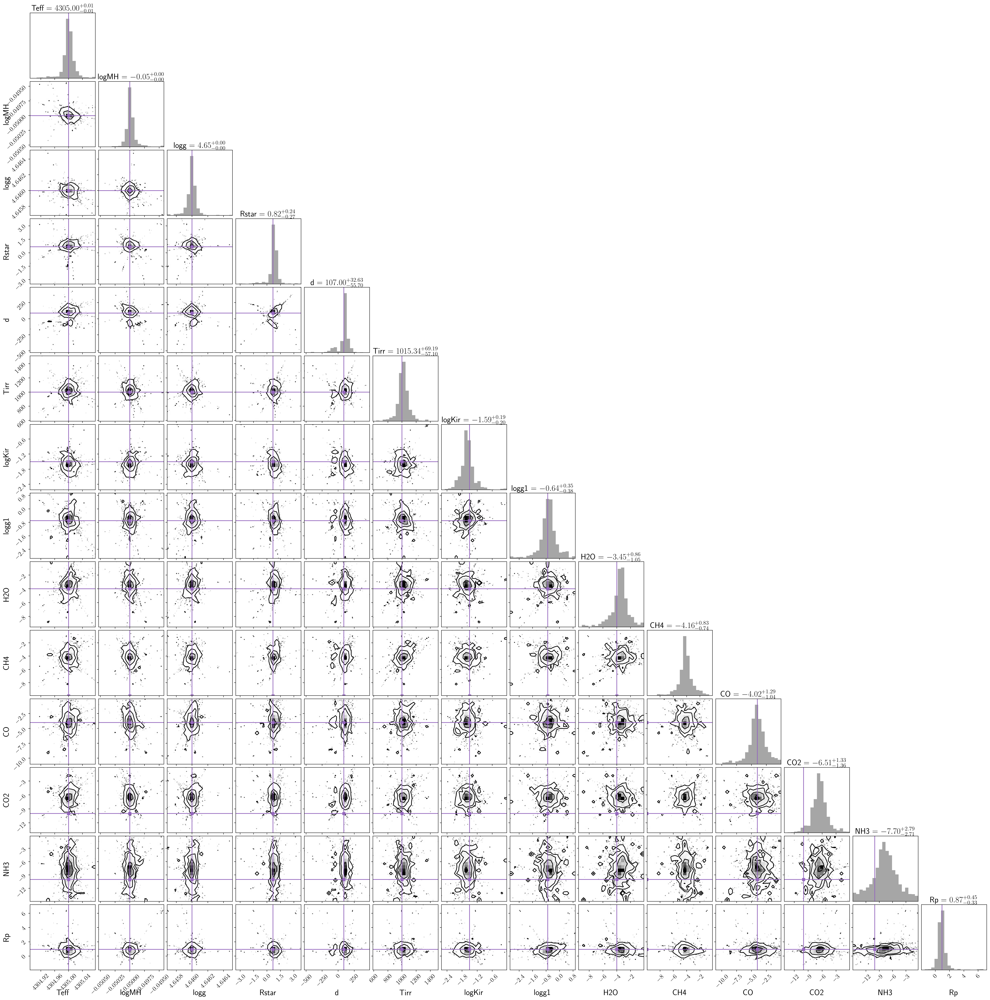

In [25]:
# Make corner plot
fig = corner.corner(flatchain, labels = theta_names, show_titles=True, truths=theta0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)

### From SPC

In [51]:
with open("test_free2_optim.pkl", 'rb') as file:
    popt, pcov, perr, p0 = pickle.load(file)

In [60]:
# Make gaussian ball 
gball2 = []
for i in range(len(exopie.THETA_NAMES)):
    # if the likelihood is a delta function
    if (perr[i] < 1e-15): 
        # Use the prior
        gball2.append(exopie.PRIORS[i])
    elif hasattr(exopie.PRIORS[i], "sigma"):
        # If the prior is more constraining than the likelihood
        if (exopie.PRIORS[i].sigma < perr[i]):
            # Use the prior
            gball2.append(exopie.PRIORS[i])
        else: 
            # Use the gaussian posterior
            gball2.append(smarter.priors.GaussianPrior(popt[i], perr[i], theta_name = exopie.THETA_NAMES[i], theta0=exopie.THETA0[i]))
    else:
        # Use the gaussian posterior
        gball2.append(smarter.priors.GaussianPrior(popt[i], perr[i], theta_name = exopie.THETA_NAMES[i], theta0=exopie.THETA0[i]))

In [61]:
# Get random samples from each of your parameters to initialize the walkers
p1 = np.vstack([dim.random_sample(p0.shape[0]) for dim in gball2]).T

In [62]:
df = pd.DataFrame(p1, columns=exopie.THETA_NAMES)
_ = sns.pairplot(df, corner=True, diag_kws={"bins" : 20, "alpha" : 1.0})